In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from mpl_toolkits import mplot3d
import tensorflow as tf
from numba import njit, jit
import time
from sklearn.utils import shuffle
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
import keras_tuner as kt
import itertools


Bad key "text.kerning_factor" on line 4 in
C:\Users\josep\anaconda3\envs\ML\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.2/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
# Defining the knot context options

problem = "0_5"      # 0_1, 3_1, 4_1, 5_1, 5_2
# problem = "SQRGRN8"  # Square, granny, 8_20
# problem = "SQRGRN"   # Square, granny
# problem = "GRN8"     # Granny, 8_20
# problem = "SQR8"     # Square, 8_20

# rep = "LOCAL"
rep = "XYZ"

# datatype = "1DWrithe"   # 1D Writhe
# datatype = "CURVATURE"  # Local Curvature
# datatype = "WCURVATURE" # Local Curvature with Window Averaging
# datatype = "LD"         # Local Density
# datatype = "Writhe"     # 3D Local Writhe
datatype = "XYZ"        # Raw XYZ Coordinates

problems = ["0_5", "SQRGRN8", "SQRGRN", "SQR8", "GRN8"]
reps = ["LOCAL", "XYZ"]
datatypes = ["1DWrithe", "CURVATURE", "WCURVATURE", "LD", "Writhe", "XYZ"]

In [3]:
def set_constants(problem):
    if problem == "0_5":
        Nconformations = 5000000 # Nconformations = Ntrials*Nknots*Nknotspertrial
        Nknots = 5
        Knotind = ['0_1', '3_1', '4_1', '5_1', '5_2']

    elif problem == "SQRGRN8":
        Nconformations = 3000000 # Nconformations = Ntrials*Nknots*Nknotspertrial
        Nknots = 3
        Knotind = ['3_1_3_1', '3_1-3_1', '8_20'] # square knot, granny knot, 8_20

    elif problem == "SQRGRN":
        Nconformations = 2000000
        Nknots = 2
        Knotind = ['3_1_3_1', '3_1-3_1'] # square knot, granny knot

    elif problem == "GRN8":
        Nconformations = 2000000
        Nknots = 2
        Knotind = ['3_1-3_1', '8_20'] # granny knot, 8_20 

    elif problem == "SQR8":
        Nconformations = 2000000
        Nknots = 2
        Knotind = ['3_1_3_1', '8_20'] # square knot, 8_20
        
    return Nconformations, Nknots, Knotind

In [4]:
# Constants
Nbeads = 100
dimensions = 3
Ntrials=10
Nknotspertrial=100000
Nconformations, Nknots, Knotind = set_constants(problem)

In [5]:
# Note: Write has window size 10 (lp10)

In [6]:
def load():
    print(datatype)
    
    if rep == "XYZ":
        data=np.zeros((Nknots*Ntrials*Nknotspertrial,Nbeads*dimensions)) # dataset[conformation][xyzcoords]
        for i in range(1):
            print(i)
            for j in range(1):
                file = "D:\PoL\Beads100\\" + str(problem) + "\\" + str(rep) + "\\" + "KNOT" + str(i) + "\\" + str(datatype) + "_KNOT" + str(Knotind[i]) + str(j) + ".dat"
                print(file)
                f = open(file,"r")
                lines=f.readlines()
                frame = int(((i*Ntrials)+j)*Nknotspertrial)
                bead = 0
                for x in lines:
                    if x == '\n':
                        frame += 1
                        bead = 0
                        continue
                    data[frame][bead] = (float(x.split(' ')[0]))
                    data[frame][bead+1] = (float(x.split(' ')[1]))
                    data[frame][bead+2] = (float(x.split(' ')[2]))
                    bead += dimensions
                f.close()    
    elif rep == "LOCAL":
        data=np.zeros((Nknots*Ntrials*Nknotspertrial,Nbeads)) # dataset[conformation][local_metric]
        for i in range(Nknots):
            print(i)
            for j in range(Ntrials):
                file = "D:\PoL\Beads100\\" + str(problem) + "\\" + str(rep) + "\\" + "KNOT" + str(i) + "\\" + str(datatype) + "_KNOT" + str(Knotind[i]) + str(j) + ".dat"
                f = open(file,"r")
                if datatype == "1DWrithe" or datatype == "Writhe":
                    lines = f.readlines()[1:]
                else:
                    lines = f.readlines()
                frame = int(((i*Ntrials)+j)*Nknotspertrial)
                bead = 0
                for k in range(len(lines)):
                    #skip first empty line and update frame and bead number
                    if (lines[k] == '\n') and (lines[(k+1)%len(lines)] == '\n'):
                        frame += 1
                        bead = 0
                        continue
                    #skip second empty line
                    if (lines[k] == '\n') and (lines[(k+1)%len(lines)] != '\n'):
                        continue
                    data[frame][bead] = (float(lines[k].split(' ')[2]))
                    bead += 1
                f.close()
    print(data.shape)
#     print("Checking for empty positions in data array...")
#     print(np.where(data==0))
    return data

In [7]:
def add_column_headers(df):
    columns = []
    
    if rep == "XYZ":
        for i in range(Nbeads):
            columns.append('x'+ str(i))
            columns.append('y' + str(i))
            columns.append('z' + str(i))  
            
    elif rep == "LOCAL":
        for i in range(Nbeads):
            columns.append('Bead'+ str(i))
            
    columns.append('label')
    df.columns=columns
    return df

In [8]:
def add_label_column(df):
    label = []
    rangeval = int(Ntrials*Nknotspertrial)
    for i in range(Nknots):
        for j in range(rangeval):
            label.append(i)    
    df['label']=label
    return df

In [9]:
def get_data_splits(df, testsize):
    x = df.drop(columns='label')
    y = df['label']
    
    values,counts = np.unique(y,return_counts=True)
    print("Unique values of label IN DATA SET are: ", values, "with frequency ", counts)
    
    x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=testsize, random_state=42)
    values,counts = np.unique(y_train,return_counts=True)
    print("Unique values of label IN TRAINING SET are: ", values, "with frequency ", counts)
    return x_train, x_test, y_train, y_test

In [10]:
def setup_NN(size_input, NN_hidden_top, hidden_activation, opt):
    model = tf.keras.models.Sequential()
#     model.add(tf.keras.layers.Flatten()) #flattens dimensions of data so its 1D and takes as input
    
    # add input layer (input_shape=(size_input,)) and first hidden layer to NN
    model.add(tf.keras.layers.Dense(
        NN_hidden_top[0],
        input_shape=(size_input,),
#         kernel_initializer = tf.keras.initializers.RandomUniform(seed=None),
        activation=hidden_activation,
        use_bias=True))

    # add hidden layers to NN 
    for i in range(len(NN_hidden_top)-1):
        model.add(tf.keras.layers.Dense(
            NN_hidden_top[i+1],
            activation=hidden_activation,
            use_bias=True))

    # add output layer 
    model.add(tf.keras.layers.Dense(
        Nknots,
        activation='softmax',
        use_bias=True))
    
    # loss function compares y_pred to y_true: in this case sparse categoricalcrossentropy
    # used for labels that are integers (CategoricalCrossEntropy used for one-hot encoding)
    loss_fn = tf.keras.losses.SparseCategoricalCrossentropy() 
    
    model.compile(optimizer=opt, #adaptive moment estimation gradient descent
                  #loss="MSE", MSE NOT VALID FOR LABELS THAT DONT REPRESENT KNOT
                  loss=loss_fn,
                  metrics=['accuracy'])
    
    # save and print NN details
    print(model.summary())
    return model

In [11]:
def setup_RNN(size_input, RNN_hidden_top, hidden_activation, opt):
    model = tf.keras.models.Sequential()

    # add input LSTM layer (input_shape=(size_input,))
    model.add(tf.keras.layers.LSTM(
        RNN_hidden_top[0],
        input_shape=(size_input,1),
        activation=hidden_activation,
        return_sequences=True))

    # add bidirectional LSTM layer
    model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(RNN_hidden_top[1], activation=hidden_activation, return_sequences=True)))

    # add intermediate LSTM layers  
    for i in range(len(RNN_hidden_top)-3):
        model.add(tf.keras.layers.LSTM(
            RNN_hidden_top[i+2],
            activation=hidden_activation,
            return_sequences=True))

    # add final LSTM layer with output only from last memory cell (a la Vandans et al.)
    model.add(tf.keras.layers.LSTM(RNN_hidden_top[-1], activation=hidden_activation))
        
    #final output layer with "Nknots" neurons for the "Nknots" knot types
    model.add(tf.keras.layers.Dense(Nknots,activation="softmax")) 
    
    #loss function compares y_pred to y_true: in this case sparse categoricalcrossentropy
    # used for labels that are integers (CategoricalCrossEntropy used for one-hot encoding)
    loss_fn = tf.keras.losses.SparseCategoricalCrossentropy() 

    model.compile(optimizer=opt, #adaptive moment estimation gradient descent
                  #loss="MSE", MSE NOT VALID FOR LABELS THAT DONT REPRESENT KNOT
                  loss=loss_fn,
                  metrics=['accuracy'])

    print(model.summary())

    return model

In [12]:
def setup_data_for_training(data):
    size = data.shape[0]
    if rep == "XYZ":
        data = np.reshape(data,(size,Nbeads*dimensions)) #reshape into row and column format
        
    df = pd.DataFrame(data) #make numpy array into pandas
    df = add_label_column(df) #add y labels column (knot type)
    df = add_column_headers(df) #add column headers for x data
    
    if rep == "XYZ":
        df = df.sample(frac=0.1).reset_index(drop=True) #shuffle conformations so not grouped by knot type 
    elif rep == "LOCAL":
        df = df.sample(frac=1).reset_index(drop=True) #shuffle conformations so not grouped by knot type
        
    return df

In [13]:
def setup_data_for_processing(data):
    data1 = np.reshape(data,(Nknots*Ntrials*Nknotspertrial, Nbeads, dimensions))
    return data1

In [14]:
def PlotConformation(conformation, title):
    fig = plt.figure(figsize=(6,5))
    ax = plt.axes(projection='3d')
    x = conformation[:,0]
    y = conformation[:,1]
    z = conformation[:,2]

    ax.plot3D(x,y,z,)
    ax.text2D(0.15, 0.85, str(title), transform=ax.transAxes)    
    ax.set_xlabel('X axis')
    ax.set_ylabel('Y axis')
    ax.set_zlabel('Z axis')

    #plot sphere (local density test) - radial threshold
#     u = np.linspace(0, np.pi, 30)
#     v = np.linspace(0, 2 * np.pi, 30)
#     x = np.outer(np.sin(u), np.sin(v))
#     y = np.outer(np.sin(u), np.cos(v))
#     z = np.outer(np.cos(u), np.ones_like(v))
#     ax.plot_wireframe(x,y,z)
    #ax.plot_surface(r*x, r*y, r*z)
    
#     c = [1,1,1]
#     r = 3
#     u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
#     x = r*np.cos(u)*np.sin(v)
#     y = r*np.sin(u)*np.sin(v)
#     z = r*np.cos(v)
#     ax.plot_surface(x-c[0], y-c[1], z-c[2], color=np.random.choice(['g','b']), alpha=0.5*np.random.random()+0.5)

    plt.savefig(str(title) + "coords.pdf")
    plt.show()    
    return

In [15]:
# data2 = setup_data_for_processing(data)
# PlotConformation(data2[11], "$0_1$") #01
# PlotConformation(data2[1000010], "$3_1$")#31
# PlotConformation(data2[2000010], "$4_1$")#41
# PlotConformation(data2[3000010], "$5_1$")#51
# PlotConformation(data2[4000011], "$5_2$")#52

In [16]:
def train(data):
    df = setup_data_for_training(data)    
    x_train,x_test,y_train,y_test = get_data_splits(df,0.1)
    
    if rep == "XYZ":
        size_input = Nbeads*dimensions
    elif rep == "LOCAL":
        size_input = Nbeads
        
    n_epoch = 1000
    NN_top = [128,128,128,128]
    RNN_top = [100,100,100,100]
    opt = tf.keras.optimizers.Adam(lr=0.001)
#     NN = setup_NN(size_input, NN_top, "relu", opt)
    NN = setup_RNN(size_input, RNN_top, "relu", opt)
    history = NN.fit(x_train, y_train, epochs = n_epoch, batch_size = 256, verbose = 1, validation_split=1/5, callbacks=cb_list) 
    y_pred = np.argmax(NN.predict(x_test), axis=-1)
    cm = confusion_matrix(y_test,y_pred)
    print(cm)
    NN.evaluate(x_test,y_test)
    
#     # list all data in history
#     print(history.history.keys())

#     # summarize history for accuracy
#     plt.plot(history.history['accuracy'])
#     plt.plot(history.history['val_accuracy'])
#     # plt.title('Accuracy vs Epoch')
#     plt.ylabel('Accuracy')
#     plt.xlabel('Epoch')
#     plt.legend(['Train', 'Validation'], loc='upper left')
#     plt.savefig("trainprocess_" + str(datatype) + ".png")
#     plt.show()
    return cm, history

In [17]:
#EARLY STOPPING Callback
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10, restore_best_weights=True,min_delta=0.01)

# Finding best NN model during training process
checkpoint_filepath = 'NN_model_best'
mc = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=False,
    monitor='val_loss',
    mode='min',
    save_best_only=True)

cb_list=[es,mc]

In [18]:
def plot_confusion_matrix(cm,
                          target_names,
                          rep,
                          prob,
                          title='Confusion matrix',
                          cmap=None,
                          normalize=True):
    """
    given a sklearn confusion matrix (cm), make a nice plot

    Arguments
    ---------
    cm:           confusion matrix from sklearn.metrics.confusion_matrix

    target_names: given classification classes such as [0, 1, 2]
                  the class names, for example: ['high', 'medium', 'low']

    title:        the text to display at the top of the matrix

    cmap:         the gradient of the values displayed from matplotlib.pyplot.cm
                  see http://matplotlib.org/examples/color/colormaps_reference.html
                  plt.get_cmap('jet') or plt.cm.Blues

    normalize:    If False, plot the raw numbers
                  If True, plot the proportions

    Usage
    -----
    plot_confusion_matrix(cm           = cm,                  # confusion matrix created by
                                                              # sklearn.metrics.confusion_matrix
                          normalize    = True,                # show proportions
                          target_names = y_labels_vals,       # list of names of the classes
                          title        = best_estimator_name) # title of graph

    Citiation
    ---------
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html

    """    
#     cm = cm/np.sum(cm)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title("Knot Rep: " + str(rep) + "; Classification: " + str(prob))
    plt.clim(0.0,1.0)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if normalize:
            plt.text(j, i, "{:0.4f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
        else:
            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
#     params = {'mathtext.default': 'regular' }          
#     plt.rcParams.update(params)

    plt.tight_layout()
    plt.ylabel('True label')
#     plt.xlabel('Predicted label\nAccuracy={:0.4f}; Misclass={:0.4f}'.format(accuracy, misclass))
    plt.xlabel('Predicted label\nAccuracy={:0.4f}'.format(accuracy))
    plt.savefig("CM-" + str(title) + ".pdf", bbox_inches='tight')
    plt.show()
    return

In [19]:
# list all data in history
# print(history.history.keys())
def plot_training(history_data):
    plt.plot(history_data.history['accuracy'])
    plt.plot(history_data.history['val_accuracy'])
    # plt.title('Accuracy vs Epoch')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.savefig("MPhysPlots\trainaccprocess_" + str(datatype) + ".pdf")
    plt.show()
    
    plt.plot(history_data.history['loss'])
    plt.plot(history_data.history['val_loss'])
    # plt.title('Loss vs Epoch')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.savefig("MPhysPlots\trainlossprocess_" + str(problem) + str(datatype) + ".pdf")
    plt.show()
    return

In [20]:
data = load()
# cm, history = train(data)
# plot_training(history)

XYZ
0
D:\PoL\Beads100\0_5\XYZ\KNOT0\XYZ_KNOT0_10.dat
(5000000, 300)


In [21]:
print(data)

[[13.3426   2.08982  1.31952 ... 12.7765   2.86712  1.01597]
 [12.8358   0.58687  0.72817 ... 12.7983   0.8155   1.62032]
 [15.9008   1.91315 -2.36826 ... 15.0452   1.84379 -1.92831]
 ...
 [ 0.       0.       0.      ...  0.       0.       0.     ]
 [ 0.       0.       0.      ...  0.       0.       0.     ]
 [ 0.       0.       0.      ...  0.       0.       0.     ]]


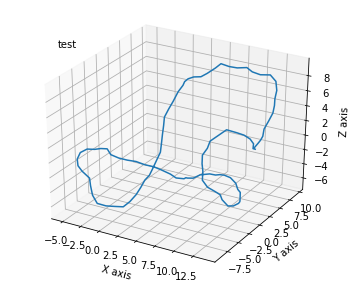

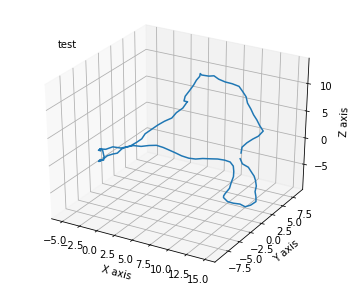

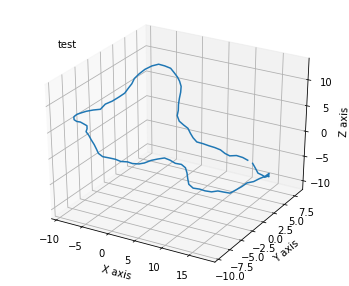

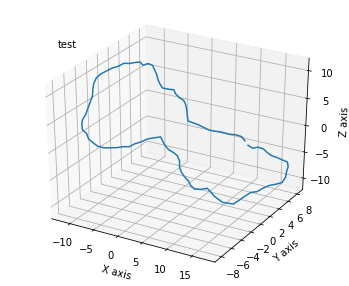

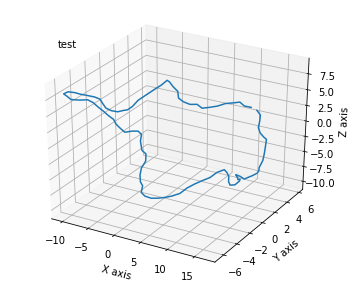

...

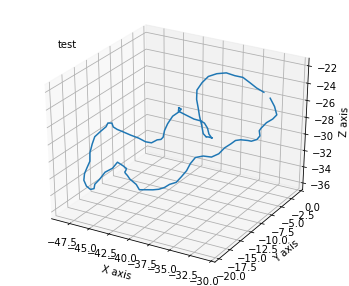

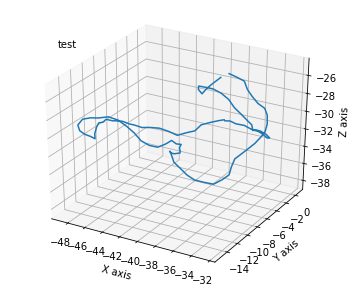

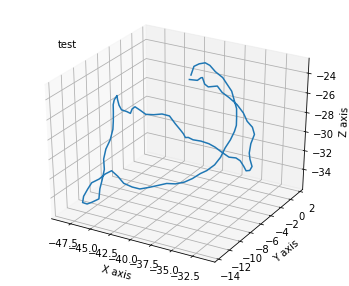

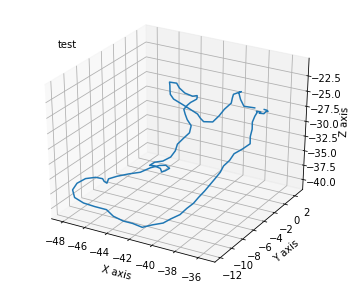

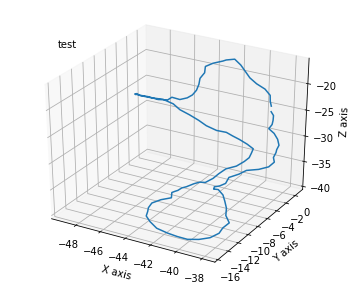

KeyboardInterrupt: 

<Figure size 432x360 with 0 Axes>

In [25]:
data = np.reshape(data, (Nconformations, Nbeads, dimensions))
for conformation in data:
    PlotConformation(conformation, "test")


In [68]:
data3DWR = load()

0
1
2
3
4
(5000000, 100)
Checking for empty positions in data array...
(array([], dtype=int64), array([], dtype=int64))


In [106]:
cm1DWR, history1DWR = train(data1DWR)

Unique values of label IN DATA SET are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label IN TRAINING SET are:  [0 1 2 3 4] with frequency  [899967 899901 899574 900332 900226]
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 128)               12928     
_________________________________________________________________
dense_11 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_12 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_13 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_14 (Dense)             (None, 5)                 645       
Total params: 63,109
Trainable 

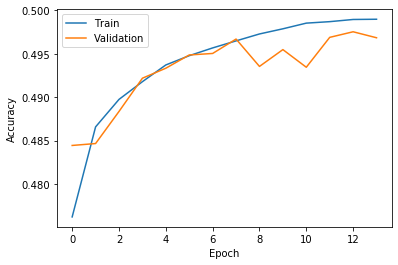

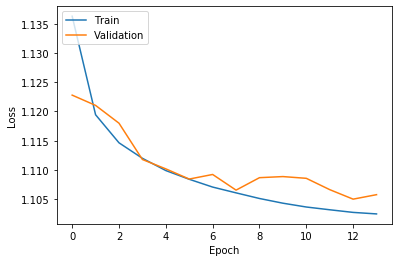

In [132]:
plot_training(history1DWR)

CURVATURE
0
1
2
3
4
(5000000, 100)
Checking for empty positions in data array...
(array([], dtype=int64), array([], dtype=int64))
Unique values of label IN DATA SET are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label IN TRAINING SET are:  [0 1 2 3 4] with frequency  [900115 899742 899782 900087 900274]
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_20 (Dense)             (None, 128)               12928     
_________________________________________________________________
dense_21 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_22 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_23 (Dense)             (None, 128)               16512     
_________________________________

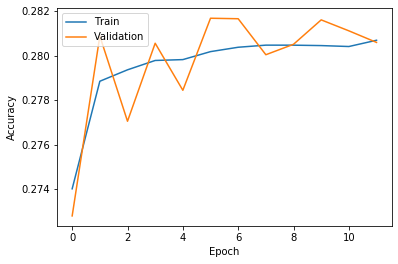

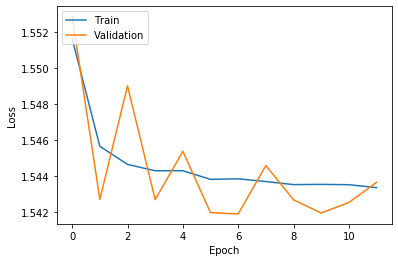

WCURVATURE
0
1
2
3
4
(5000000, 100)
Checking for empty positions in data array...
(array([], dtype=int64), array([], dtype=int64))
Unique values of label IN DATA SET are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label IN TRAINING SET are:  [0 1 2 3 4] with frequency  [900133 900660 899628 899766 899813]
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_25 (Dense)             (None, 128)               12928     
_________________________________________________________________
dense_26 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_27 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_28 (Dense)             (None, 128)               16512     
________________________________

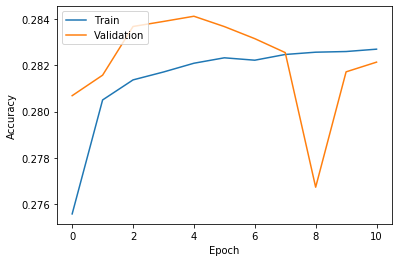

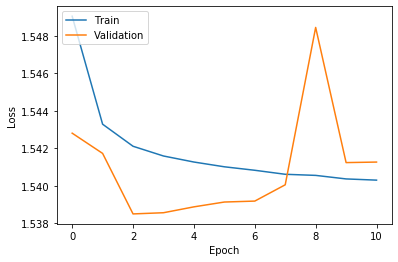

In [153]:
data1DWR = []
datatype = "CURVATURE"
data = load()
cmLC, historyLC = train(data)
plot_training(historyLC)

datatype = "WCURVATURE"
data = load()
cmWLC, historyWLC = train(data)
plot_training(historyWLC)

Writhe
0
1
2
3
4
(5000000, 100)
Checking for empty positions in data array...
(array([], dtype=int64), array([], dtype=int64))
Unique values of label IN DATA SET are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label IN TRAINING SET are:  [0 1 2 3 4] with frequency  [900160 899900 900287 899702 899951]
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_30 (Dense)             (None, 128)               12928     
_________________________________________________________________
dense_31 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_32 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_33 (Dense)             (None, 128)               16512     
____________________________________

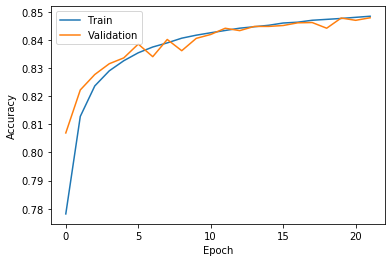

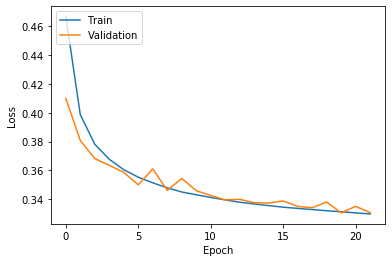

In [158]:
datatype = "Writhe"
data = load()
cmLC, historyLC = train(data)
plot_training(historyLC)

PLOTTING AND EXTRAS

In [16]:
Knottitle = ['$0_1$','$3_1$','$4_1$','$5_1$','$5_2$']

In [ ]:
plot_confusion_matrix(cm           = np.array([[ 6257,  1204,   573, 1029, 984],
                                               [ 755, 6520,  974,  886,  909],
                                               [ 826, 1038, 6127, 1160,  747],
                                               [ 816, 1154,  797, 6279,  855],
                                               [ 895, 1285,  627,  795, 6508]]), 
                      normalize    = True,
                      target_names = Knottitle,
                      title        = "Raw-XYZ-5KNOT-100BEADS",
                     rep = "Raw XYZ",
                     prob = "5 100-Bead Knots")

In [37]:
cmldn = train(dataLD/Nbeads)

Unique values of label are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 128)               12928     
_________________________________________________________________
dense_2 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_3 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_4 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_5 (Dense)              (None, 5)                 645       
Total params: 63,109
Trainable params: 63,109
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/10
1

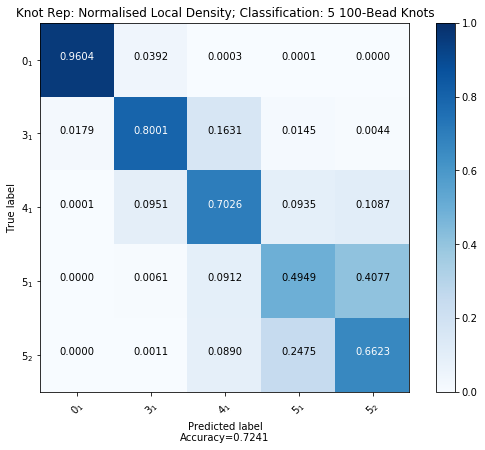

In [38]:
plot_confusion_matrix(cm           = cmldn ,
                      normalize    = True,
                      target_names = Knottitle,
                      title        = "LD-Normalised-5KNOT-100BEADS",
                     rep = "Normalised Local Density",
                     prob = "5 100-Bead Knots")

In [39]:
cmld = train(dataLD)

Unique values of label are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 128)               12928     
_________________________________________________________________
dense_7 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_8 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_9 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_10 (Dense)             (None, 5)                 645       
Total params: 63,109
Trainable params: 63,109
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/10
1

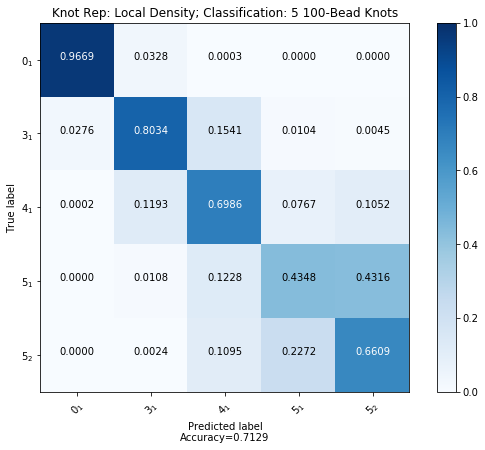

In [40]:
plot_confusion_matrix(cm           = cmld,
                      normalize    = True,
                      target_names = Knottitle,
                      title        = "LD-5KNOT-100BEADS",
                     rep = "Local Density",
                     prob = "5 100-Bead Knots")

In [17]:
cm3dwr = train(dataWR)

Unique values of label are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label are:  [0 1 2 3 4] with frequency  [899613 899768 900376 900455 899788]
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 128)               12928     
_________________________________________________________________
dense_1 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_2 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_3 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_4 (Dense)              (None, 5)                 645       
Total params: 63,109
Trainable params: 63,109
Non-trainable p

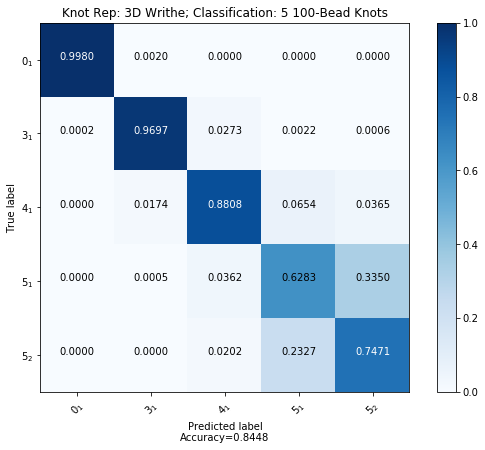

In [19]:
plot_confusion_matrix(cm           = cm3dwr,
                      normalize    = True,
                      target_names = Knottitle,
                      title        = "3D-Writhe-5KNOT-100BEADS",
                     rep = "3D Writhe",
                     prob = "5 100-Bead Knots")

In [20]:
#NORMALISING BY THE MAX AND MIN DIFFERENCE VALUES
normconstant = (np.max(dataWR) - np.abs(np.min(dataWR)))/2
normfactor = np.max(dataWR) - normconstant
normWR = (dataWR-normconstant)/normfactor
normWR.shape

(5000000, 100)

In [23]:
cm3dwrn = train(normWR)

Unique values of label are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label are:  [0 1 2 3 4] with frequency  [899892 900083 899740 900295 899990]
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 128)               12928     
_________________________________________________________________
dense_11 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_12 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_13 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_14 (Dense)             (None, 5)                 645       
Total params: 63,109
Trainable params: 63,109
Non-trainable

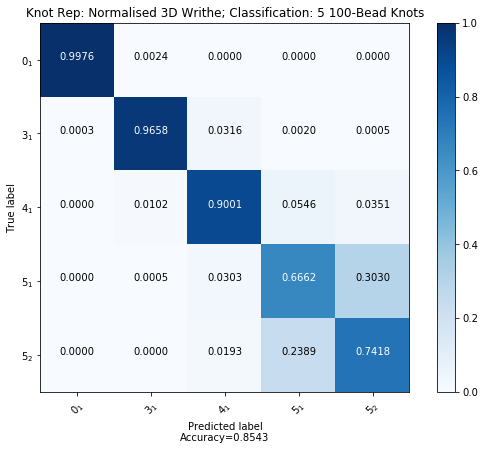

In [24]:
plot_confusion_matrix(cm           = cm3dwrn,
                      normalize    = True,
                      target_names = Knottitle,
                      title        = "3D-Writhe-Normalised-5KNOT-100BEADS-test",
                     rep = "Normalised 3D Writhe",
                     prob = "5 100-Bead Knots")

LOCAL DENSITY NORMALISED

In [ ]:
dataLDNorm = dataLD/Nbeads

LOCAL DENSITY

ADJACENT

In [22]:
@njit
def get_adjacent(dataset):
    adjacent = np.zeros((len(dataset), Nbeads,dimensions))
    for i in range(len(dataset)):
        for j in range(Nbeads):
            for d in range(dimensions):
                adjacent[i][j][d] = dataset[i][(j+1)%Nbeads][d]-dataset[i][j][d]
    return adjacent

In [23]:
data = setup_data_for_processing(data)
print(data)

[[[13.3426   2.08982  1.31952]
  [13.597    1.07718  1.89837]
  [13.9169   0.56231  2.8395 ]
  ...
  [12.3866   5.12862  1.0056 ]
  [12.6411   4.05617  1.10388]
  [12.7765   2.86712  1.01597]]

 [[12.8358   0.58687  0.72817]
  [13.0906   0.69366 -0.19888]
  [13.6701   1.10741 -0.90413]
  ...
  [13.2953   1.25736  3.36512]
  [12.7802   1.03956  2.54778]
  [12.7983   0.8155   1.62032]]

 [[15.9008   1.91315 -2.36826]
  [16.587    1.70635 -3.00229]
  [17.215    1.54084 -3.71152]
  ...
  [13.5792   1.07596 -0.86554]
  [14.3848   1.50872 -1.33233]
  [15.0452   1.84379 -1.92831]]

 ...

 [[ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  ...
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]]

 [[ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  ...
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]
  [ 0.       0.       0.     ]]

 [[ 0.       0.       0.

In [24]:
adjacent = get_adjacent(data)


In [25]:
print(adjacent[0])
print(adjacent)

[[ 0.2544  -1.01264  0.57885]
 [ 0.3199  -0.51487  0.94113]
 [-0.181   -0.51787  0.8081 ]
 [-0.495   -0.55012  0.62225]
 [-0.4646  -0.84021  0.5569 ]
 [-1.1265  -0.31562  0.25114]
 [-0.8229  -0.3036  -0.77486]
 [-0.84271 -0.43696 -0.78759]
 [-0.27369 -0.12477 -0.96153]
 [-0.55357 -0.13878 -0.9792 ]
 [ 0.14479 -0.31499 -0.96836]
 [ 0.12661 -0.02347 -0.97924]
 [ 0.07151 -0.22266 -1.08135]
 [ 0.50166  0.32106 -0.97071]
 [ 0.6026   0.73018 -0.787  ]
 [ 0.2156   0.7966  -0.74739]
 [-0.0255   0.49857 -0.90988]
 [ 0.4971   0.511   -0.97691]
 [ 0.2244   0.9104  -0.37199]
 [ 0.0634   1.1124  -0.14318]
 [-0.3265   0.9215  -0.27881]
 [-0.434    0.8422  -0.26158]
 [-0.4451   0.83211  0.57286]
 [-0.72903  0.70263 -0.07493]
 [-0.69893  0.74924  0.34967]
 [-0.97624  0.42983  0.34776]
 [-1.10151  0.49106 -0.13952]
 [-0.95993  0.60896 -0.43311]
 [-0.82991  0.40229 -0.44343]
 [-1.06177  0.42231 -0.29001]
 [-1.00717 -0.54839 -0.14393]
 [-0.37996 -1.00706 -0.12314]
 [-0.21997 -0.99929  0.40382]
 [ 0.25677

NORMALISED ADJACENT

In [29]:
@njit
def get_normalised_adjacent(adjacent_dataset):
    normalisedadjacent = np.zeros((len(adjacent_dataset), Nbeads, dimensions))
    normconstant = (np.max(adjacent) - np.abs(np.min(adjacent)))/2
    normfactor = np.max(adjacent) - normconstant       
    
    for i in range(len(adjacent_dataset)):
        for j in range(Nbeads):
            for d in range(dimensions):
                normalisedadjacent[i][j][d] = (adjacent_dataset[i][j][d]-normconstant)/normfactor
    return normalisedadjacent

In [ ]:
norm = get_normalised_adjacent(data)

In [ ]:
print(norm)

In [26]:
#NORMALISING BY THE MAX AND MIN DIFFERENCE VALUES
normconstant = (np.max(adjacent) - np.abs(np.min(adjacent)))/2
normfactor = np.max(adjacent) - normconstant
normalisedadjacent = (adjacent-normconstant)/normfactor
normalisedadjacent.shape

(5000000, 100, 3)

In [28]:
print(normalisedadjacent[0])
print(normalisedadjacent)

[[ 0.20960826 -0.82824729  0.47537116]
 [ 0.2632605  -0.42051482  0.77212131]
 [-0.14703582 -0.42297217  0.66315401]
 [-0.40423894 -0.44938873  0.51092089]
 [-0.37933774 -0.68700674  0.45739152]
 [-0.92151209 -0.25730551  0.20693793]
 [-0.6728278  -0.24745971 -0.63347736]
 [-0.68905453 -0.35669732 -0.64390474]
 [-0.22295988 -0.1009768  -0.78638216]
 [-0.45221469 -0.11245264 -0.80085598]
 [ 0.11982471 -0.25678947 -0.79197674]
 [ 0.10493314 -0.01800012 -0.80088874]
 [ 0.05979973 -0.18116028 -0.8845289 ]
 [ 0.41214343  0.26421068 -0.79390166]
 [ 0.49482522  0.59932832 -0.64342146]
 [ 0.17782647  0.65373416 -0.61097618]
 [-0.01966293  0.40961235 -0.7440747 ]
 [ 0.40840825  0.41979399 -0.7989802 ]
 [ 0.18503471  0.74694981 -0.3034792 ]
 [ 0.05315668  0.91241169 -0.11605676]
 [-0.26621752  0.75604202 -0.22715377]
 [-0.35427273  0.69108595 -0.21304036]
 [-0.36336494  0.68282104  0.47046464]
 [-0.59593717  0.57676162 -0.06015195]
 [-0.57128172  0.61494072  0.28764565]
 [-0.79843139  0.35330617

In [58]:
normalisedadjacent = []
data = []

In [54]:
print(normalisedadjacent[0])
print(normalisedadjacentjacentdadjacentalisedadjacent)

[[ 0.20960826 -0.82824729  0.47537116]
 [ 0.2632605  -0.42051482  0.77212131]
 [-0.14703582 -0.42297217  0.66315401]
 [-0.40423894 -0.44938873  0.51092089]
 [-0.37933774 -0.68700674  0.45739152]
 [-0.92151209 -0.25730551  0.20693793]
 [-0.6728278  -0.24745971 -0.63347736]
 [-0.68905453 -0.35669732 -0.64390474]
 [-0.22295988 -0.1009768  -0.78638216]
 [-0.45221469 -0.11245264 -0.80085598]
 [ 0.11982471 -0.25678947 -0.79197674]
 [ 0.10493314 -0.01800012 -0.80088874]
 [ 0.05979973 -0.18116028 -0.8845289 ]
 [ 0.41214343  0.26421068 -0.79390166]
 [ 0.49482522  0.59932832 -0.64342146]
 [ 0.17782647  0.65373416 -0.61097618]
 [-0.01966293  0.40961235 -0.7440747 ]
 [ 0.40840825  0.41979399 -0.7989802 ]
 [ 0.18503471  0.74694981 -0.3034792 ]
 [ 0.05315668  0.91241169 -0.11605676]
 [-0.26621752  0.75604202 -0.22715377]
 [-0.35427273  0.69108595 -0.21304036]
 [-0.36336494  0.68282104  0.47046464]
 [-0.59593717  0.57676162 -0.06015195]
 [-0.57128172  0.61494072  0.28764565]
 [-0.79843139  0.35330617

In [24]:
def PlotAdjacent(data, normalised, number, title):
    beadlist = np.arange(0,Nbeads)
    deltax = []
    deltay = []
    deltaz = []
    for i in range(Nbeads):
        deltax.append(data[number][i][0])
        deltay.append(data[number][i][1])
        deltaz.append(data[number][i][2])
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(3, 1, 1)
    ax.plot(beadlist, deltax)
    plt.ylabel("$\Delta$ x")
    ax = fig.add_subplot(3, 1, 2)
    ax.plot(beadlist, deltay)
    plt.ylabel("$\Delta$ y")
    ax = fig.add_subplot(3, 1, 3)
    ax.plot(beadlist, deltaz)
    plt.ylabel("$\Delta$ z")
#     plt.suptitle("Distances between adjacent monomers: " + str(title))
    plt.xlabel("Bead Index")
    if normalised:
        plt.savefig(str(title) + "-" + str(number) + "-NormAdjacentPlot.pdf")
    else:
        plt.savefig(str(title) + "-" + str(number) + "-AdjacentPlot.pdf")
    plt.show()
    return

COM

In [25]:
@njit
def get_COM(conformation):
    comx = 0
    comy = 0
    comz = 0
    for n in range(Nbeads):
        comx+=conformation[n][0]
        comy+=conformation[n][1]
        comz+=conformation[n][2]
    comx/=Nbeads
    comy/=Nbeads
    comz/=Nbeads
    return comx,comy,comz

In [ ]:
#Calc COM per conformation using get_COM function
t0 = time.time()
COM = np.zeros((Nknots*Ntrials*Nknotspertrial,dimensions))
for i in range(Nknots*Ntrials*Nknotspertrial):
    COM[i][0],COM[i][1], COM[i][2] = get_COM(data2[i])
np.shape(COM)
t1 = time.time()
print(t1-t0)

In [26]:
@njit
def translatebead(conformation, COM):
    x = np.zeros((Nbeads))
    y = np.zeros((Nbeads))
    z = np.zeros((Nbeads))
    for j in range(Nbeads):
        x[j] = conformation[j][0] - COM[0]
        y[j] = conformation[j][1] - COM[1]
        z[j] = conformation[j][2] - COM[2]
    return x,y,z

In [ ]:
t0 = time.time()
translatedCOMData = np.zeros((Nknots*Ntrials*Nknotspertrial, Nbeads, dimensions))
for i in range(Nknots*Ntrials*Nknotspertrial):
        translatedCOMData[i,:,0], translatedCOMData[i,:,1], translatedCOMData[i,:,2] = translatebead(data2[i],COM[i])
        
t1 = time.time()
print(t1-t0)

In [ ]:
PlotConformation(translatedCOMData[11], "$0_1$") #01
PlotConformation(translatedCOMData[1000010], "$3_1$")#31
PlotConformation(translatedCOMData[2000010], "$4_1$")#41
PlotConformation(translatedCOMData[3000010], "$5_1$")#51
PlotConformation(translatedCOMData[4000011], "$5_2$")#52

3D WRITHE

3D WRITHE NORMALISED

In [52]:
#NORMALISING BY THE MAX AND MIN DIFFERENCE VALUES
normconstant = (np.max(dataWR) - np.abs(np.min(dataWR)))/2
normfactor = np.max(dataWR) - normconstant
normWR = (dataWR-normconstant)/normfactor
normWR.shape

(5000000, 100)

In [ ]:
NN = tf.keras.models.load_model(checkpoint_filepath)

MANUAL TUNING TESTS

KERAS TUNER

In [58]:
if rep == "XYZ":
    size_input = Nbeads*dimensions
elif rep == "LOCAL":
    size_input = Nbeads
    
def build_model(hp):
    model = tf.keras.models.Sequential()
    
#     model.add(tf.keras.layers.Dense(
#         units = hp.Int('units_0', 32, 512, step=32),
#         input_shape=(size_input,),
#         activation="relu"))
    
    # input layer
    model.add(tf.keras.layers.Flatten(input_shape=(size_input,)))
    
    # hidden layers
    for i in range(hp.Int('layers', 2, 6)):
        model.add(tf.keras.layers.Dense(units=hp.Int('units_' + str(i), 32, 512, step=32),
                                    activation="relu"))
   
    # output layer
    model.add(tf.keras.layers.Dense(Nknots, activation='softmax'))
    
    loss_fn = tf.keras.losses.SparseCategoricalCrossentropy() 
    opt = tf.keras.optimizers.Adam(lr=hp.Choice("lr", values = [.1,.01,.001,.0001,.00001]))
    
    model.compile(optimizer=opt,
              loss=loss_fn,
              metrics=['accuracy'])

    return model

In [59]:
# HyperBand algorithm from keras tuner
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=10,
    directory='keras_tuner_dir',
    project_name='MPhysProject'
)

INFO:tensorflow:Reloading Oracle from existing project keras_tuner_dir\MPhysProject\oracle.json
INFO:tensorflow:Reloading Tuner from keras_tuner_dir\MPhysProject\tuner0.json


In [60]:
def tune(data):
    df = setup_data_for_training(data)    
    x_train,x_test,y_train,y_test = get_data_splits(df,0.1)      
    tuner.search(x_train, y_train, epochs=10, batch_size = 256, verbose = 1, validation_split=1/5, callbacks = cb_list)
    return tuner

In [34]:
data3DWR = load()

Writhe
0
1
2
3
4
(5000000, 100)
Checking for empty positions in data array...
(array([], dtype=int64), array([], dtype=int64))


In [61]:
tuner = tune(data3DWR)

Unique values of label IN DATA SET are:  [0 1 2 3 4] with frequency  [1000000 1000000 1000000 1000000 1000000]
Unique values of label IN TRAINING SET are:  [0 1 2 3 4] with frequency  [900364 899559 900273 900187 899617]

Search: Running Trial #1

Hyperparameter    |Value             |Best Value So Far 
layers            |5                 |4                 
units_0           |288               |512               
units_1           |480               |384               
lr                |0.01              |0.001             
units_2           |512               |256               
units_3           |192               |224               
units_4           |352               |384               
tuner/epochs      |2                 |2                 
tuner/initial_e...|0                 |0                 
tuner/bracket     |2                 |2                 
tuner/round       |0                 |0                 

Epoch 1/2
 1314/14063 [=>............................] - ETA: 1:23 

KeyboardInterrupt: 

In [ ]:
best_model = tuner.get_best_models()[0]

In [ ]:
# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}.
""")

In [ ]:
# Delete NN model
tf.keras.backend.clear_session()

In [16]:
# #Coulomb Matrix Rep. (rotationally and tranaslationally invariant)
# from ase.io import read
# from dscribe.descriptors import CoulombMatrix
# name = ".xyz"

# structures = read(name,index=":")
# cm = CoulombMatrix(n_atoms_max=100,flatten=True,sparse=False)
# cm_beads = cm.create(structures,n_jobs=1)
# labels=[]
# for i in range(Nknots):
#     val = 0
#     for j in range(int(Nconformations/Nknots)):
#         labels.append(val)
#     val +=1
# x = np.array(cm_beads)
# y = np.array(labels)